In [1]:
%matplotlib inline

# Tiled - Analysis

In [2]:
import json
from pathlib import Path

import pandas as pd
import numpy as np

## Data

In [3]:
RAW_DATA_ROOT_ATTENUATED = Path("C:/Users/Monthy/Documents/projects/thesis/thesis-data-suite/data/raw/forward_deferred")

SCENES_ATTENUATED = { "pipers-alley" : [  "58#1x_1y_1z"
                                        
                                        , "116#1x_1y_2z"
                                        , "116#1x_2y_1z"
                                        , "116#2x_1y_1z"
                                        
                                        , "174#1x_1y_3z"
                                        , "174#1x_3y_1z"
                                        , "174#3x_1y_1z"
                                        
                                        , "232#1x_2y_2z"
                                        , "232#2x_1y_2z"
                                        , "232#2x_2y_1z"
                                        
                                        , "348#1x_2y_3z"
                                        , "348#1x_3y_2z"
                                        , "348#2x_1y_3z"
                                        , "348#2x_3y_1z"
                                        , "348#3x_2y_1z"
                                        , "348#3x_1y_2z"
                                        
                                        , "464#2x_2y_2z"
                                        
                                        , "522#1x_3y_3z"
                                        , "522#3x_1y_3z"
                                        , "522#3x_3y_1z"
                                        
                                        , "696#2x_2y_3z"
                                        , "696#2x_3y_2z"
                                        , "696#3x_2y_2z"
                                        
                                        , "1044#2x_3y_3z"
                                        , "1044#3x_2y_3z"
                                        , "1044#3x_3y_2z"
                                       ]
                     , "ziggurat-city" : [ "65#1x_1y_1z"                             
                                         
                                          , "130#1x_1y_2z"
                                          , "130#1x_2y_1z"
                                          , "130#2x_1y_1z"
                                          
                                          , "195#3x_1y_1z"
                                          , "195#1x_3y_1z"
                                          , "195#1x_1y_3z"
                                          
                                          , "260#1x_2y_2z"
                                          , "260#2x_1y_2z"
                                          , "260#2x_2y_1z"
                                          
                                          , "390#1x_2y_3z"
                                          , "390#1x_3y_2z"
                                          , "390#2x_1y_3z"
                                          , "390#2x_3y_1z"
                                          , "390#3x_2y_1z"
                                          , "390#3x_1y_2z"
                                          , "520#2x_2y_2z"
                                          
                                          , "585#1x_3y_3z"
                                          , "585#3x_1y_3z"
                                          , "585#3x_3y_1z"
                                          
                                          , "780#2x_2y_3z"
                                          , "780#2x_3y_2z"
                                          , "780#3x_2y_2z"
                                          
                                          , "1170#2x_3y_3z"
                                          , "1170#3x_2y_3z"
                                          , "1170#3x_3y_2z"
                                         ]
                     , "spaceship-indoor" : [ "70#1x_1y_1z"
                                             
                                             , "140#1x_1y_2z"
                                             , "140#1x_2y_1z"
                                             , "140#2x_1y_1z"
                                             
                                             , "210#1x_1y_3z"
                                             , "210#1x_3y_1z"
                                             , "210#3x_1y_1z"
                                             
                                             , "280#1x_2y_2z"
                                             , "280#2x_1y_2z"
                                             , "280#2x_2y_1z"
                                             
                                             , "420#1x_2y_3z"
                                             , "420#1x_3y_2z"
                                             , "420#2x_1y_3z"
                                             , "420#2x_3y_1z"
                                             , "420#3x_1y_2z"
                                             , "420#3x_2y_1z"
                                             
                                             , "560#2x_2y_2z"
                                             
                                             , "630#1x_3y_3z"
                                             , "630#3x_1y_3z"
                                             , "630#3x_3y_1z"
                                             
                                             , "840#2x_2y_3z"
                                             , "840#2x_3y_2z"
                                             , "840#3x_2y_2z"
                                             
                                             , "1260#2x_3y_3z"
                                             , "1260#3x_2y_3z"
                                             , "1260#3x_3y_2z"
                                            ]
                    }


RESOLUTIONS_ATTENUATED = [ 160
                          , 320
                          , 640
                          , 960
                          , 1280
                          , 1920
                          , 2560
                         ]

PIPELINE_TYPES = [ "forward"
                 , "deferred" 
                 ]

In [4]:
RAW_DATA_ROOT_TILED = Path("C:/Users/Monthy/Documents/projects/thesis/thesis-data-suite/data/raw/tiled")

SCENES_TILED = { "pipers-alley" : [  "58#1x_1y_1z"
                                   
                                , "116#1x_1y_2z"
                                , "116#1x_2y_1z"
                                ,  "116#2x_1y_1z"

                                , "174#1x_1y_3z"
                                , "174#1x_3y_1z"
                                , "174#3x_1y_1z"

                                , "232#1x_2y_2z"
                                , "232#2x_1y_2z"
                                , "232#2x_2y_1z"

                                , "348#1x_2y_3z"
                                , "348#1x_3y_2z"
                                , "348#2x_1y_3z"
                                , "348#2x_3y_1z"
                                , "348#3x_2y_1z"
                                , "348#3x_1y_2z"

                                , "464#2x_2y_2z"

                                , "522#1x_3y_3z"
                                , "522#3x_1y_3z"
                                , "522#3x_3y_1z"

                                , "696#2x_2y_3z"
                                , "696#2x_3y_2z"
                                , "696#3x_2y_2z"

                                , "1044#2x_3y_3z"
                                , "1044#3x_2y_3z"
                                , "1044#3x_3y_2z"
                                ]
               , "ziggurat-city" : [ "65#1x_1y_1z"

                                 , "130#1x_1y_2z"
                                 , "130#1x_2y_1z"
                                 , "130#2x_1y_1z"

                                 , "195#3x_1y_1z"
                                 , "195#1x_3y_1z"
                                 , "195#1x_1y_3z"

                                 , "260#1x_2y_2z"
                                 , "260#2x_1y_2z"
                                 , "260#2x_2y_1z"

                                 , "390#1x_2y_3z"
                                 , "390#1x_3y_2z"
                                 , "390#2x_1y_3z"
                                 , "390#2x_3y_1z"
                                 , "390#3x_2y_1z"
                                 , "390#3x_1y_2z"

                                 , "520#2x_2y_2z"

                                 , "585#1x_3y_3z"
                                 , "585#3x_1y_3z"
                                 , "585#3x_3y_1z"

                                 , "780#2x_2y_3z"
                                 , "780#2x_3y_2z"
                                 , "780#3x_2y_2z"

                                 , "1170#2x_3y_3z"
                                 , "1170#3x_2y_3z"
                                 , "1170#3x_3y_2z"
                                 ]
               , "spaceship-indoor" : [ "70#1x_1y_1z"

                                      , "140#1x_1y_2z"
                                      , "140#1x_2y_1z"
                                      , "140#2x_1y_1z"

                                      , "210#1x_1y_3z"
                                      , "210#1x_3y_1z"
                                      , "210#3x_1y_1z"

                                      , "280#1x_2y_2z"
                                      , "280#2x_1y_2z"
                                      , "280#2x_2y_1z"

                                      , "420#1x_2y_3z"
                                      , "420#1x_3y_2z"
                                      , "420#2x_1y_3z"
                                      , "420#2x_3y_1z"
                                      , "420#3x_1y_2z"
                                      , "420#3x_2y_1z"

                                      , "560#2x_2y_2z"

                                      , "630#1x_3y_3z"
                                      , "630#3x_1y_3z"
                                      , "630#3x_3y_1z"

                                      , "840#2x_2y_3z"
                                      , "840#2x_3y_2z"
                                      , "840#3x_2y_2z"

                                      , "1260#2x_3y_3z"
                                      , "1260#3x_2y_3z"
                                      , "1260#3x_3y_2z"
                                      ]
         }

RESOLUTIONS_TILED = [ 640
                     , 960
                     , 1280
                     , 1920
                    ]

TILE_SIZES = [ 8
              , 16
              , 32
              , 64
             ]

In [5]:
def json_to_dataframe(json_dic : dict) -> pd.DataFrame:
    '''
    Convert a json data file spit out by nTiled into something just slightly more useful
    '''
    # get all functions tracked from first frame
    frames = json_dic["frames"]
    functions = list(x for x in frames[0]["functions"])
    
    # build empty dictionary which will be loaded with data from frames
    data_raw = { fn : {} for fn in functions }    
    frames_i = {}
    
    for f in frames:
        f_i = int(f["frame"])
        frames_i[f_i] = f_i
        for fn in functions:
            if fn in f["functions"]:
                data_raw[fn][f_i] = float(f["functions"][fn])
            
    data_series = {fn : pd.Series(data_raw[fn], name=fn) for fn in functions }
    data_series["index"] = pd.Series(frames_i, name="index")
    
    dataframe = pd.DataFrame(data_series)
    return dataframe

In [6]:
def retrieve_attenuated_data():
    '''
    Retrieve all data created for deferred shading
    '''
    n_tests = 3
    
    data = {}
    
    pt_dict = {}
    for pt in PIPELINE_TYPES:
        path_pt = RAW_DATA_ROOT_ATTENUATED / Path(pt)
        
        scene_dict = {}
        for scene in SCENES_ATTENUATED:
            path_scene = path_pt / Path(scene)
            
            ld_dict = {}
            for light_def in SCENES_ATTENUATED[scene]:
                path_ld = path_scene / Path(light_def)
                
                res_dict = {}
                for res in RESOLUTIONS_ATTENUATED:
                    path_res = path_ld / Path("{}".format(res))
                    
                    dataframes = []
                    for i in range(n_tests):
                        file_path = path_res / Path("data_{}.json".format(i))
                        
                        with open(str(file_path), 'r') as f:
                            data_json = json.loads(f.read())
                            
                        dataframes.append(json_to_dataframe(data_json))
                        
                    res_dict[res] = dataframes
                ld_dict[light_def] = res_dict
            scene_dict[scene] = ld_dict
        pt_dict[pt] = scene_dict
    
    return pt_dict

In [7]:
def retrieve_tiled_data():
    '''
    Retrieve all data created for deferred shading
    '''
    n_tests = 3
    
    data = {}
    
    pt_dict = {}
    for pt in PIPELINE_TYPES:
        path_pt = RAW_DATA_ROOT_TILED / Path(pt)
        
        scene_dict = {}
        for scene in SCENES_TILED:
            path_scene = path_pt / Path(scene)
            
            ld_dict = {}
            for light_def in SCENES_TILED[scene]:
                path_ld = path_scene / Path(light_def)
                
                res_dict = {}
                for res in RESOLUTIONS_TILED:
                    path_res = path_ld / Path("{}".format(res))
                    
                    ts_dict = {}
                    for ts in TILE_SIZES:
                        path_ts = path_res / Path("{}".format(ts))                  
                        
                        dataframes = []
                        for i in range(n_tests):
                            file_path = path_ts / Path("data_{}.json".format(i))
                            
                            with open(str(file_path), 'r') as f:
                                data_json = json.loads(f.read())        
                            
                            v = json_to_dataframe(data_json)
                            v = v.drop(v.index[-1])
                            dataframes.append(v)
                        
                        ts_dict[ts] = dataframes
                    res_dict[res] = ts_dict
                ld_dict[light_def] = res_dict
            scene_dict[scene] = ld_dict
        pt_dict[pt] = scene_dict
    
    return pt_dict

In [8]:
data_attenuated = retrieve_attenuated_data()

In [9]:
data_tiled = retrieve_tiled_data()

## Plots

In [10]:
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf', 'svg')
matplotlib.rcParams['svg.fonttype'] = 'none'

In [11]:
def average_tests(df_l : list) -> pd.DataFrame:
    frame_mean = pd.concat(df_l)
    by_row_index = frame_mean.groupby(frame_mean.index)
    df_means = by_row_index.mean()
    
    return df_means


def plot_frame(scene: str, res: int, l_def: str, pipeline_type: str, tile_size : int ):
    df_attenuated = average_tests(data_attenuated[pipeline_type][scene][l_def][res])
    
    df_tiled = average_tests(data_tiled[pipeline_type][scene][l_def][res][tile_size])
    col_list = list(x for x in df_tiled if (x != 'index') and (x != 'ForwardTiledShader::renderObjects'))
    
    df_tiled.loc[:, 'grid'] = df_tiled[col_list].sum(axis=1)
    df_tiled.loc[:, 'total'] = df_tiled[['ForwardTiledShader::renderObjects', 'grid',]].sum(axis=1)
        
    sns.regplot("index", "{}AttenuatedShader::renderObjects".format(pipeline_type.title()), 
                data=df_attenuated, fit_reg=False, 
                label="Attenuated")
    ax = sns.regplot("index", "grid", 
                     data=df_tiled, fit_reg=False, 
                     label="Tiled - Grid")
    ax = sns.regplot("index", "total", 
                     data=df_tiled, fit_reg=False, 
                     label="Tiled - Total")

    
    ax.set(xlabel='Frames', ylabel='Execution time (ms)')
    ax.legend()         
    ax.set_title("Frames - {} | {} | {} | {}".format(res, tile_size, pipeline_type.title(), l_def))
    
    plt.show()

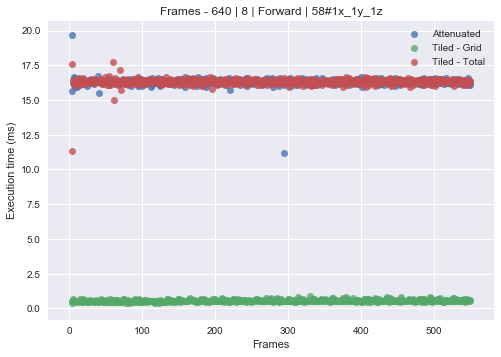

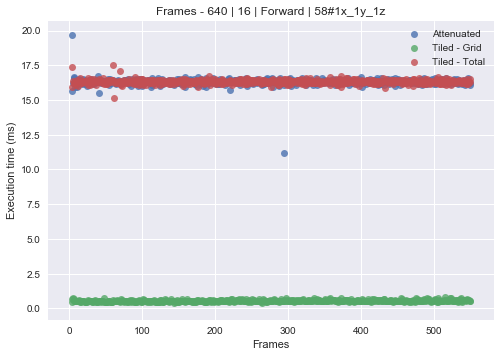

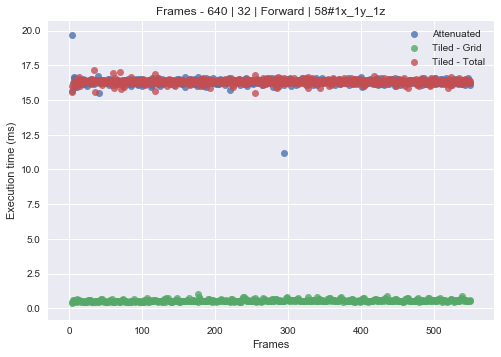

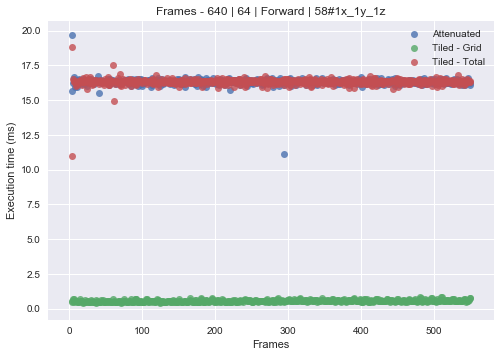

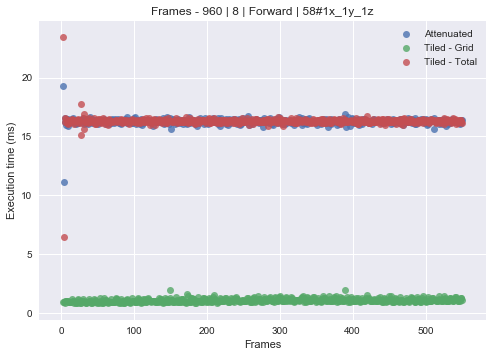

...

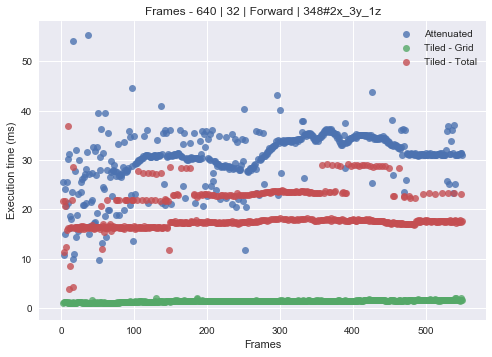

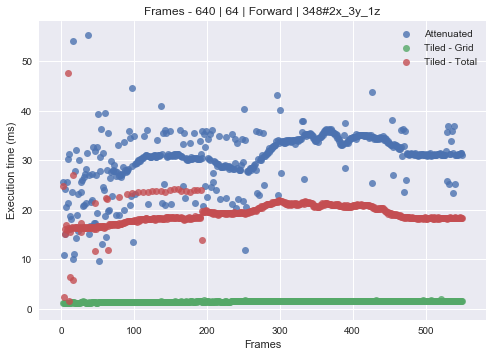

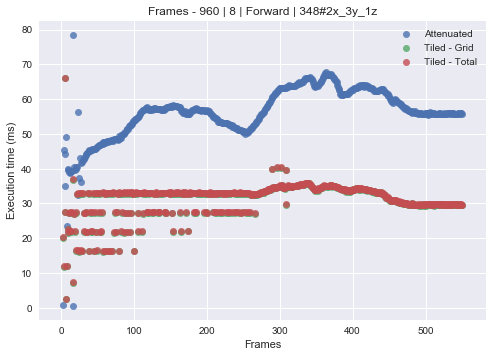

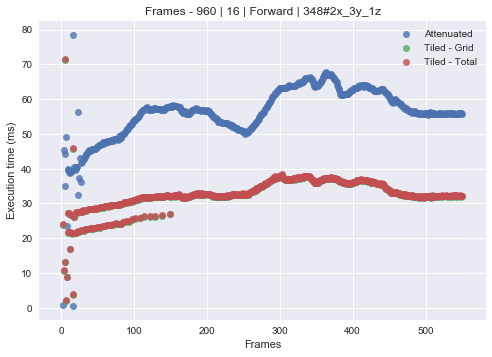

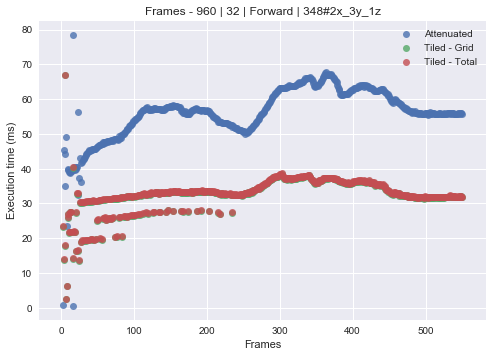

In [ ]:
scene = "pipers-alley"
for pipeline_type in PIPELINE_TYPES:
    for l_def in SCENES_TILED[scene]:
        for res in RESOLUTIONS_TILED:
            for ts in TILE_SIZES:
                plot_frame(scene, res, l_def, pipeline_type, ts)

In [ ]:
scene = "spaceship-indoor"
for pipeline_type in PIPELINE_TYPES:
    for l_def in SCENES_TILED[scene]:
        for res in RESOLUTIONS_TILED:
            for ts in TILE_SIZES:
                plot_frame(scene, res, l_def, pipeline_type, ts)

In [ ]:
scene = "ziggurat-city"
for pipeline_type in PIPELINE_TYPES:
    for l_def in SCENES_TILED[scene]:
        for res in RESOLUTIONS_TILED:
            for ts in TILE_SIZES:
                plot_frame(scene, res, l_def, pipeline_type, ts)

In [46]:
def plot_resolution(scene: str, l_def: str, pipeline_type: str):
    df_attenuated = pd.DataFrame([], columns=["execution_time", "resolution"])
    df_tiles = {}
    for x in TILE_SIZES:
        df_tiles[x] = pd.DataFrame([], columns=["execution_time", "resolution"])
    
    index = 0
    
    # build data
    for res in RESOLUTIONS_TILED:
        for i in range(3):
            df_attenuated.loc[index] = [data_attenuated[pipeline_type][scene][l_def][res][i].mean(axis=0).iloc[0], res]
            
            for x in TILE_SIZES:                
                df = data_tiled[pipeline_type][scene][l_def][res][x][i]                
                col_list = list(x for x in df if x != 'index')
                
                df_tiles[x].loc[index] = [(df.mean(axis=0))[col_list].sum(), res]            
            index += 1

    # plot
    sns.regplot("resolution", "execution_time", 
                data=df_attenuated, fit_reg=False, 
                label="Attenuated")
    for x in TILE_SIZES:
        ax = sns.regplot("resolution", "execution_time", 
                         data=df_tiles[x], fit_reg=False, 
                         label="Tiled - {}".format(x))
    
    ax.set(xlabel='Resolution (px)', ylabel='Execution time (ms)')
    ax.legend()         
    ax.set_title("Resolution - {} - {}".format(pipeline_type, l_def))
    
    plt.show()

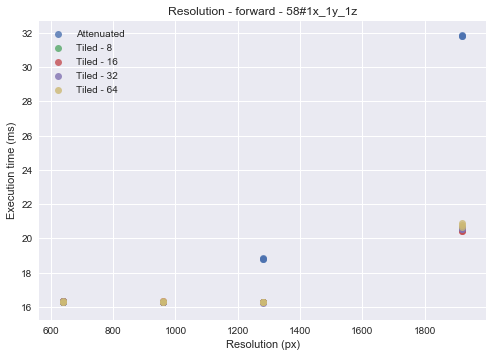

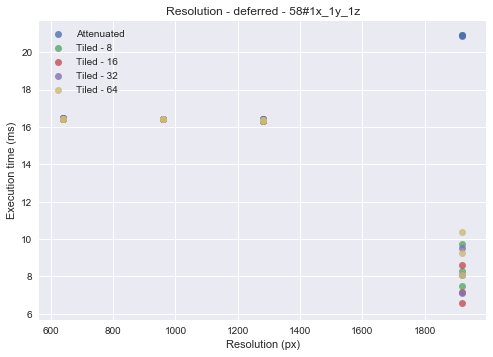

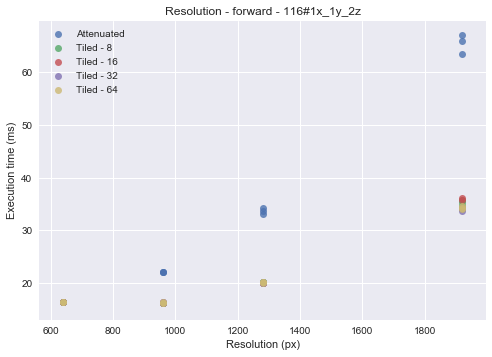

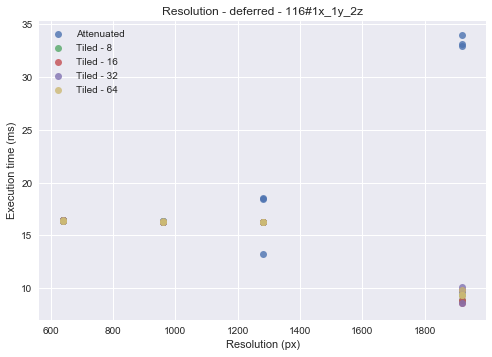

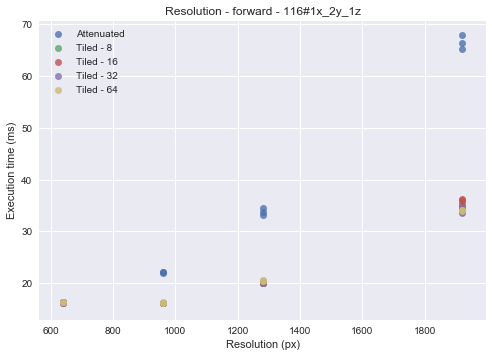

...

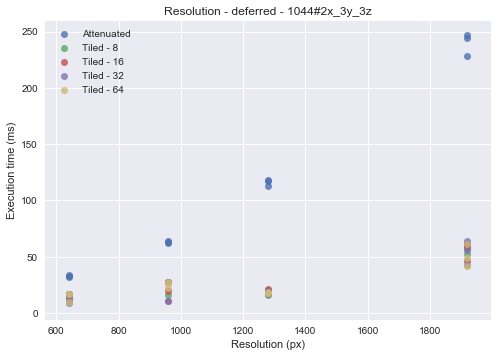

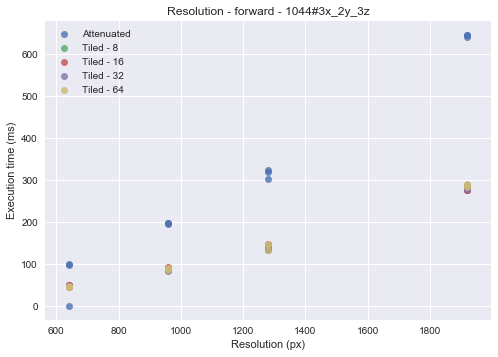

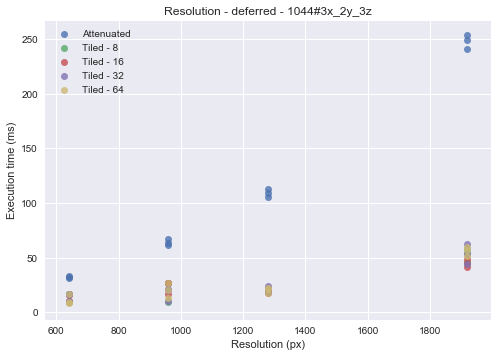

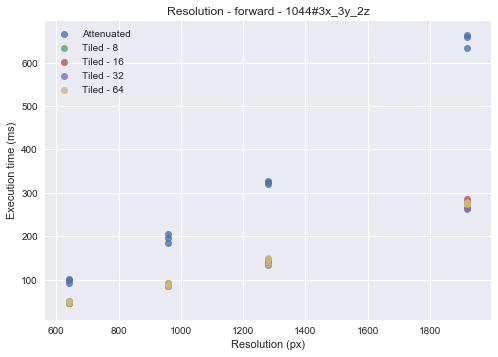

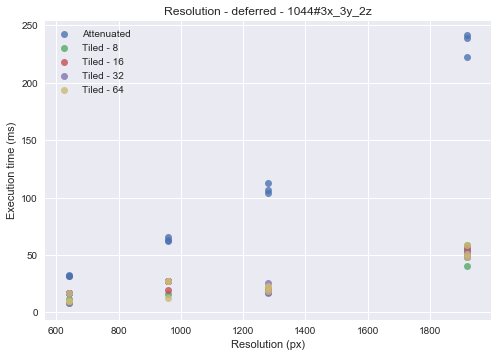

In [47]:
scene = "pipers-alley"
for l_def in SCENES_TILED[scene]:
    for pt in PIPELINE_TYPES:
        plot_resolution(scene, l_def, pt)

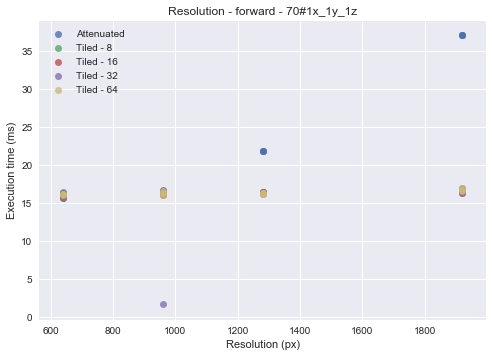

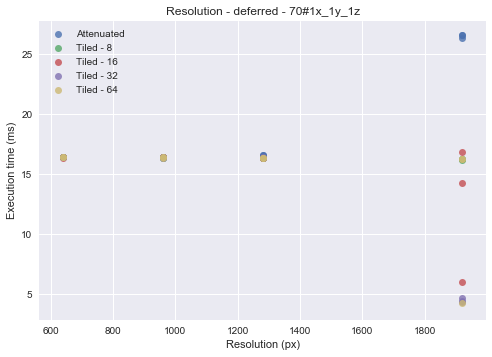

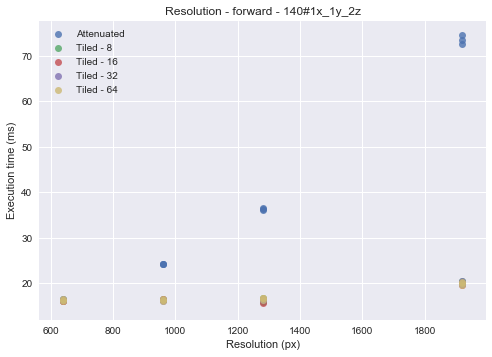

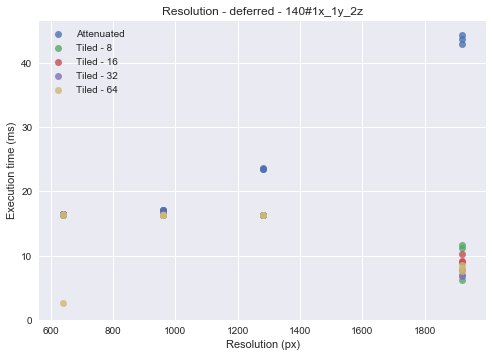

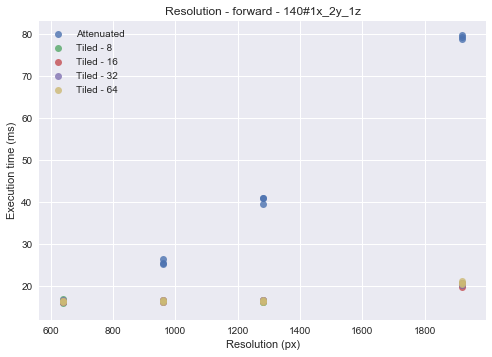

...

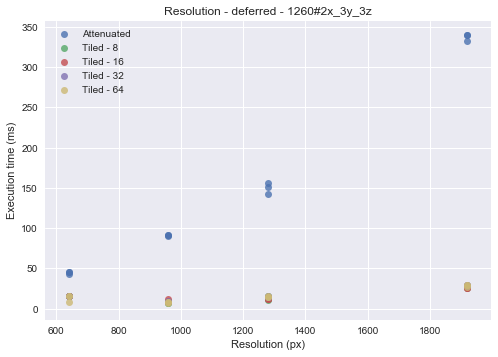

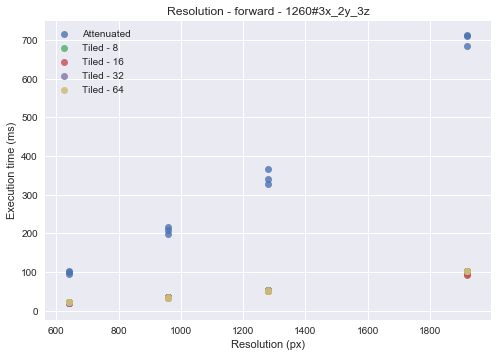

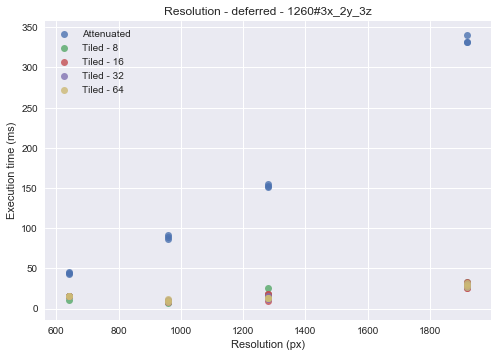

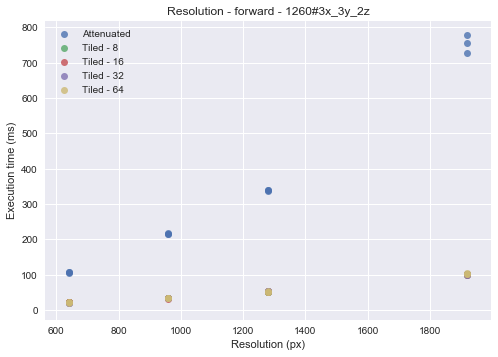

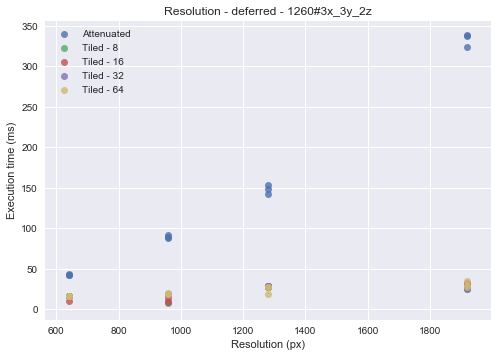

In [48]:
scene = "spaceship-indoor"
for l_def in SCENES_TILED[scene]:
    for pt in PIPELINE_TYPES:
        plot_resolution(scene, l_def, pt)

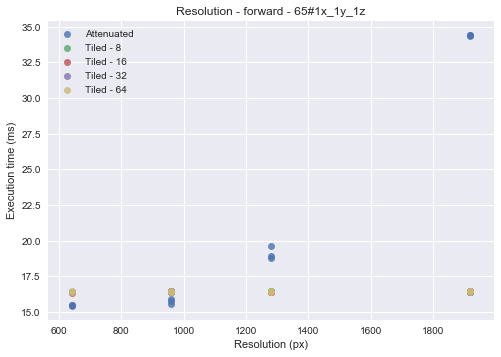

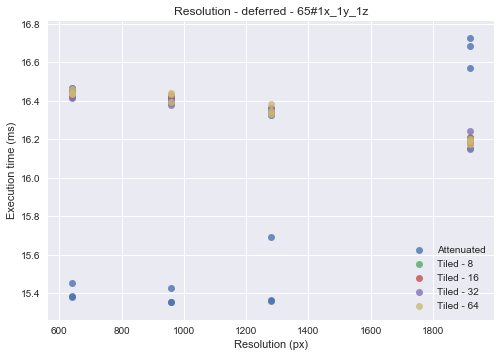

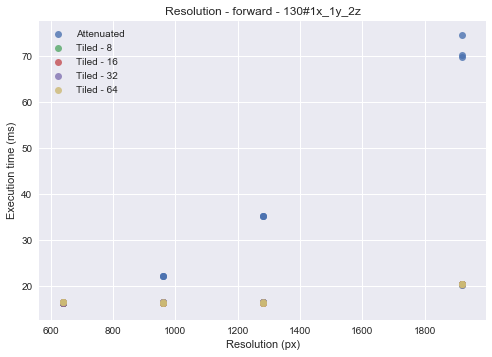

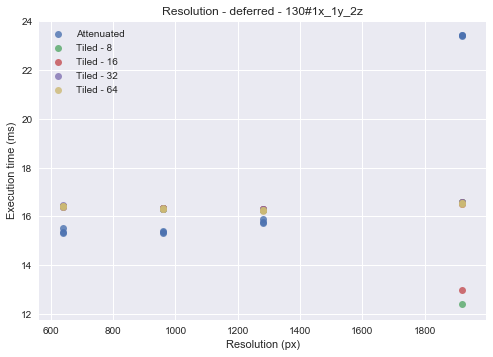

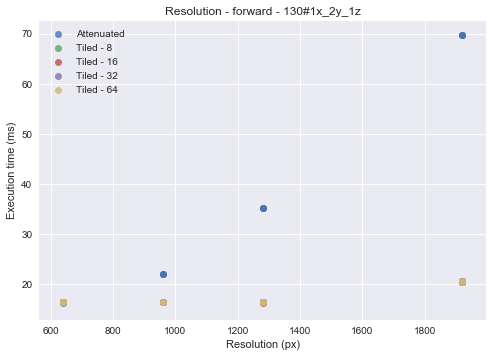

...

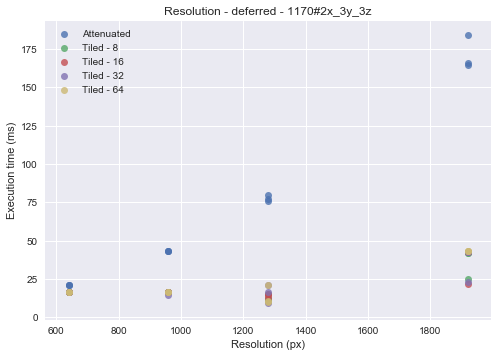

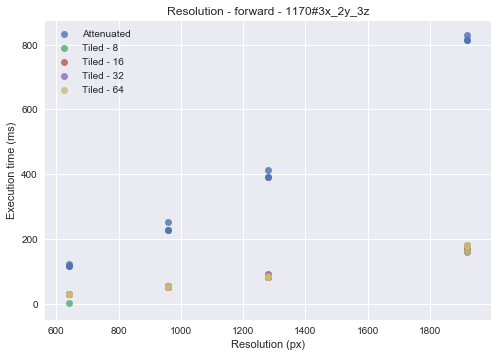

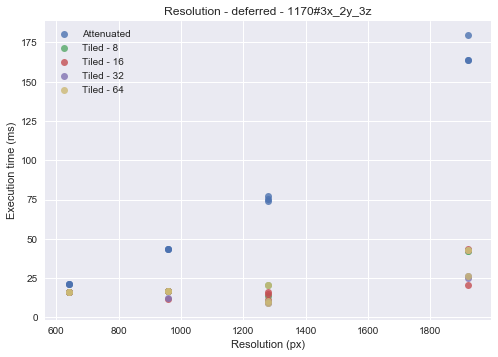

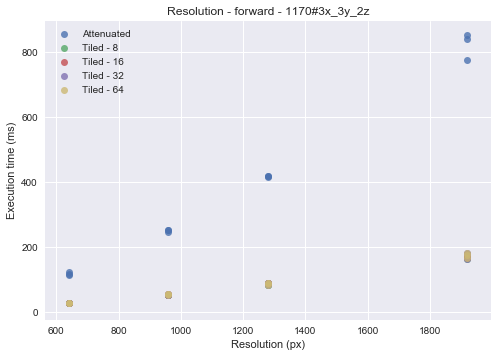

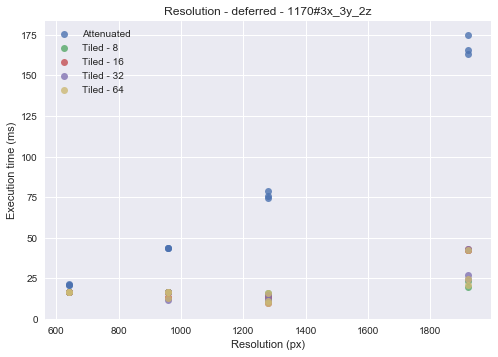

In [49]:
scene = "ziggurat-city"
for l_def in SCENES_TILED[scene]:
    for pt in PIPELINE_TYPES:
        plot_resolution(scene, l_def, pt)